# Task 4 : Image Reconstruction using Matrix Factorisation [4 Marks]

In [2]:
import torch
import torchvision

device = torch.device('mps' if torch.backends.mps.is_available() else 'cpu')

import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
from latexify import latexify, format_axes

from utils import mask_image, factorize, metrics, random_mask_image, train, create_rff_features, create_linear_model, extract_not_nan_coordinates_pixels, create_coordinate_map

## Question 1
Pick an image of your liking and reconstruct it using matrix factorization. Choose a suitable value for the rank $r$. Run Gradient Descent until it converges, plot the reconstructed image alongside the original image. Calculate and report the RMSE and PSNR metrics. [1 Marks]

In [3]:
def plot_image_completion(img,
                          prop_list,
                          factors_list,
                          device): 
    
    latexify()
    fig = plt.figure(figsize=(len(factors_list) * 4, len(prop_list) * 18), dpi=300)
    gs = GridSpec(3*len(prop_list)+1, len(factors_list), figure=fig)
    
    curr_row = 0
    for i, prop in enumerate(prop_list):
        masked_img, mask = mask_image(img=img,
                                  prop=prop,
                                  device=device)
        
        axorg = fig.add_subplot(gs[curr_row, 0:len(factors_list)//2])
        axmask = fig.add_subplot(gs[curr_row, len(factors_list)//2:])
        curr_row += 1

        axorg.imshow(img.permute(1,2,0).cpu().numpy())
        axorg.set_title(f"Original image")
        format_axes(axorg)

        axmask.imshow(masked_img.permute(1,2,0).cpu().numpy())
        axmask.set_title(f"Masked image with prop={prop}")
        format_axes(axmask)

        rmses = []
        psnrs = []
        for j, r in enumerate(factors_list):
            Wr, Hr, lossr = factorize(masked_img[0], r, device=device)
            Wg, Hg, lossg = factorize(masked_img[1], r, device=device)
            Wb, Hb, lossb = factorize(masked_img[2], r, device=device)
            reconstructed_img = torch.clamp(torch.stack([torch.mm(Wr, Hr).detach(), torch.mm(Wg, Hg).detach(), torch.mm(Wb, Hb).detach()], dim=0), 0, 1)

            rmse, psnr = metrics(img, reconstructed_img)
        
            rmses.append(rmse.cpu().numpy())
            psnrs.append(psnr.cpu().numpy())

            # Plot reconstructed image with metrics in the loop
            ax = fig.add_subplot(gs[curr_row, j])
            ax.imshow(reconstructed_img.permute(1,2,0).cpu().numpy())
            ax.set_title(f"prop= {prop}, r={r}, RMSE={rmse:.4f}, PSNR={psnr:.4f}")
            format_axes(ax)
        curr_row += 1
        # Plot RMSE and PSNR vs r outside the loop
        axrmse = fig.add_subplot(gs[curr_row,0:len(factors_list)//2])
        axrmse.plot(factors_list, rmses, marker='o')
        axrmse.set_xlabel('r')
        axrmse.set_ylabel('RMSE')
        axrmse.set_title('RMSE vs r')
        format_axes(axrmse)
        axpsnr = fig.add_subplot(gs[curr_row,len(factors_list)//2:])
        axpsnr.plot(factors_list, psnrs, marker='o')
        axpsnr.set_xlabel('r')
        axpsnr.set_ylabel('PSNR')
        axpsnr.set_title('PSNR vs r')
        format_axes(axpsnr)
        curr_row += 1

    # Make the layout tight for better appearance
    plt.tight_layout()
    plt.show()

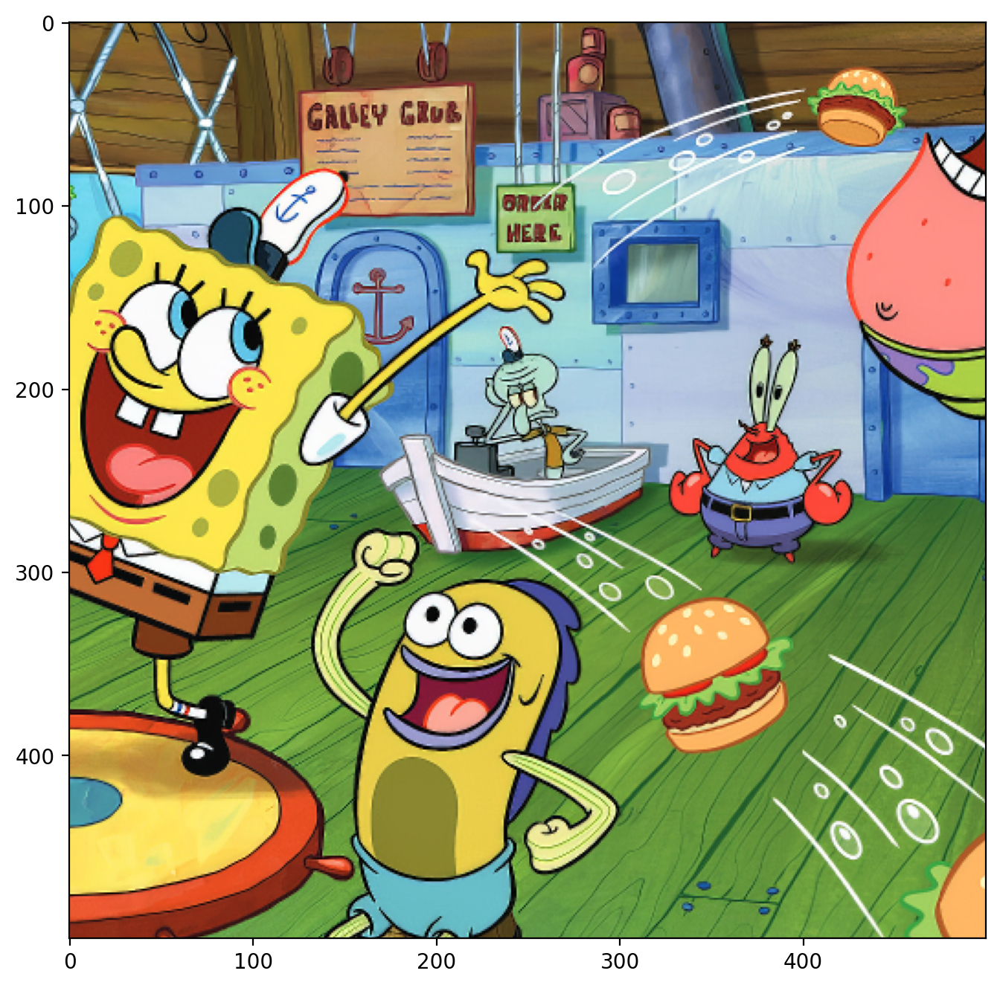

In [4]:
krustykrab = torchvision.io.read_image("images/krustykrab.png")
krustykrab = krustykrab.to(dtype=torch.float32, device=device)/255

transform = torchvision.transforms.CenterCrop((500, 500))

krustykrab = transform(krustykrab)

plt.figure(figsize=(12, 8))  
plt.imshow(krustykrab.permute(1,2,0).cpu().numpy())
plt.show()

In [35]:
plot_image_completion(krustykrab, prop_list=[0.2, 0.5, 0.9], factors_list=[50,100,300,500], device=device)

## Question 2
Consider a case where 900 pixels (30x30) are randomly missing from an image. Reconstruct the image using matrix factorization, plot the reconstructed image, and calculate the RMSE and PSNR metrics. Next, reconstruct the same image with the missing pixels using Random Fourier Features (RFF) and Linear Regression. Compute the RMSE and PSNR for both methods, and compare the results to see which performs better.\
[3 Marks]

In [4]:
rff_masked, mask = random_mask_image(krustykrab, device)

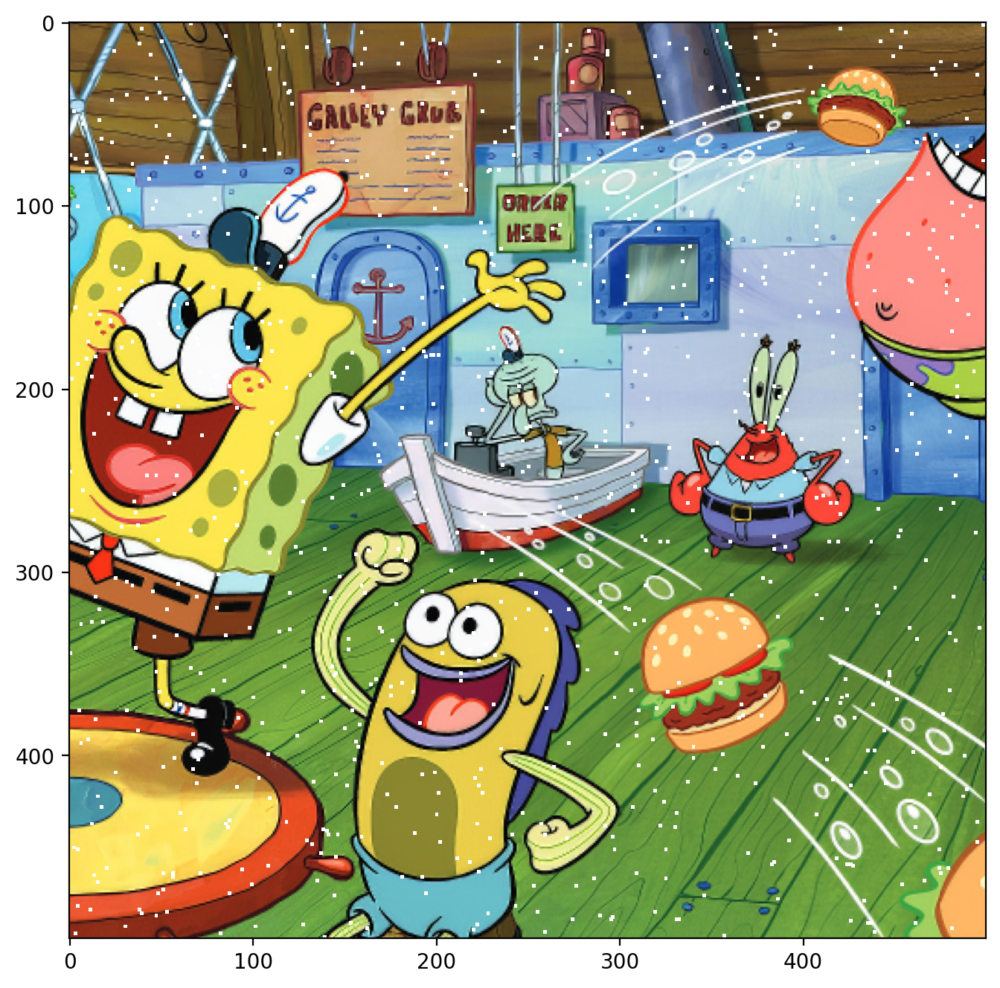

In [5]:
# increase figsize
plt.figure(figsize=(12, 8))
plt.imshow(rff_masked.permute(1,2,0).detach().cpu().numpy())
plt.show()

In [6]:
rff_masked.shape

torch.Size([3, 500, 500])

In [7]:
# we need these coordinates when testing
coords_org = create_coordinate_map(krustykrab.shape[1], krustykrab.shape[2], device=device)
# model: 10000 features -> 3 color channels : happens for each pixel

# training: image_rff (<250000, 10000)
# testing: test_rff (250000, 10000)
# test_rff = create_rff_features(coords_org, 10000, 0.008)

In [8]:
coords, pixel_values = extract_not_nan_coordinates_pixels(rff_masked, device=device) # corresponding pixel values for the masked image
# nans removed

Coordinates shape:  torch.Size([249100, 2])
Pixel values shape:  torch.Size([249100, 3])


In [9]:
sigma = 3.25
features = 10000

In [10]:
image_rff = create_rff_features(coords, features, sigma, device=device)
# get rff features for <250000 pixels

In [11]:
image_rff.shape

torch.Size([249100, 10000])

In [12]:
model = create_linear_model(image_rff.shape[1], 3, device=device)
model.to(device)

train(image_rff, pixel_values, model, learning_rate=0.01,
      epochs=10000, threshold=1e-9, verbose=True) # feeding < 250000 image_rff and correspondoing pixel values

Epoch 0 loss: 0.336702
Epoch 100 loss: 0.020939
Epoch 200 loss: 0.016822
Epoch 300 loss: 0.016085
Epoch 400 loss: 0.015929
Epoch 500 loss: 0.015882
Epoch 600 loss: 0.015858
Epoch 700 loss: 0.015841
Epoch 800 loss: 0.015828
Epoch 900 loss: 0.015817
Epoch 1000 loss: 0.015808
Epoch 1100 loss: 0.015800
Epoch 1200 loss: 0.015793
Epoch 1300 loss: 0.015786
Epoch 1400 loss: 0.015781
Epoch 1500 loss: 0.015776
Epoch 1600 loss: 0.015771
Epoch 1700 loss: 0.015766
Epoch 1800 loss: 0.015762
Epoch 1900 loss: 0.015759
Epoch 2000 loss: 0.015755
Epoch 2100 loss: 0.015752
Epoch 2200 loss: 0.015749
Epoch 2300 loss: 0.015746
Epoch 2400 loss: 0.015743
Epoch 2500 loss: 0.015740
Epoch 2600 loss: 0.015738
Epoch 2700 loss: 0.015735
Epoch 2800 loss: 0.015733
Epoch 2900 loss: 0.015731
Epoch 3000 loss: 0.015728
Epoch 3100 loss: 0.015726
Epoch 3200 loss: 0.015724
Epoch 3300 loss: 0.015722
Epoch 3400 loss: 0.015720
Epoch 3500 loss: 0.015719
Epoch 3600 loss: 0.015717
Epoch 3700 loss: 0.015715
Epoch 3800 loss: 0.01571

0.015681028366088867

In [13]:
model(image_rff).shape

torch.Size([249100, 3])

In [14]:
test_rff = create_rff_features(coords_org, features, sigma, device=device)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.12230289..1.2673509].


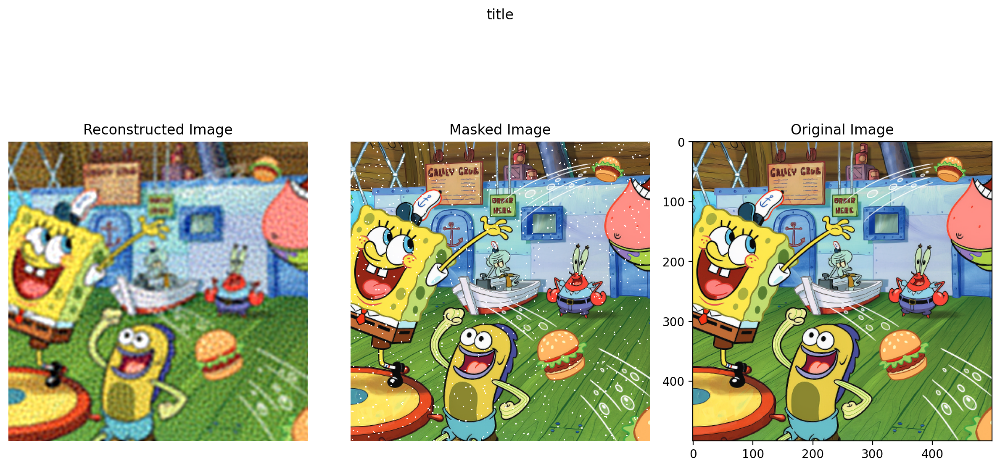

In [15]:
model.eval()
with torch.no_grad():
    outputs = model(test_rff).reshape(500, 500, 3)

fig = plt.figure(figsize=(12, 8))
# this allows us to create a flexible grid layout for plotting multiple subplots
gs = GridSpec(1, 3, width_ratios=[1, 1, 1])
ax0 = plt.subplot(gs[0])
ax1 = plt.subplot(gs[1])
ax2 = plt.subplot(gs[2])
ax0.imshow(outputs.detach().cpu().numpy())
ax0.set_title("Reconstructed Image")
ax1.imshow(rff_masked.permute(1,2,0).detach().cpu().numpy())
ax1.set_title("Masked Image")
ax2.imshow(krustykrab.permute(1, 2, 0).cpu())
ax2.set_title("Original Image")
for a in [ax0, ax1]:
    a.axis("off")
fig.suptitle("title", y=0.9)
plt.tight_layout()

In [16]:
rmse, psnr = metrics(krustykrab, outputs.permute(2, 0, 1))
print(rmse, psnr)

tensor(0.1252, device='mps:0') tensor(18.0455, device='mps:0')


In [5]:
def plot_rff_mf_comparision(img, device, r, sigma, features):
    
    random_masked = random_mask_image(img, device=device)[0]
    
    Wr, Hr, lossr = factorize(random_masked[0], r, device=device)
    Wg, Hg, lossg = factorize(random_masked[1], r, device=device)
    Wb, Hb, lossb = factorize(random_masked[2], r, device=device)
    reconstructed_mf = torch.clamp(torch.stack([torch.mm(Wr, Hr).detach(), torch.mm(Wg, Hg).detach(), torch.mm(Wb, Hb).detach()], dim=0), 0, 1)

    rmse_mf, psnr_mf = metrics(img, reconstructed_mf)

    coords_org = create_coordinate_map(img.shape[1], img.shape[2], device=device)
    coords, pixel_values = extract_not_nan_coordinates_pixels(random_masked, device=device) # corresponding pixel values for the masked image
    image_rff = create_rff_features(coords, features, sigma, device=device)
    model = create_linear_model(image_rff.shape[1], 3, device=device).to(device)
    train(image_rff, pixel_values, model, learning_rate=0.01, epochs=10000, threshold=1e-9, verbose=False)
    test_rff = create_rff_features(coords_org, features, sigma, device=device)
    model.eval()
    with torch.no_grad():
        reconstructed_rrf = torch.clamp(model(test_rff).reshape(500, 500, 3), 0, 1)

    rmse_rff, psnr_rff = metrics(img, reconstructed_rrf.permute(2, 0, 1))

    latexify()
    fig = plt.figure(figsize=(12, 8), dpi = 300)
    gs = GridSpec(2, 2,figure=fig)

    ax_org = plt.subplot(gs[0, 0])
    ax_org.imshow(img.permute(1,2,0).cpu().numpy())
    ax_org.set_title("Original Image")
    format_axes(ax_org)

    ax_rm = plt.subplot(gs[0, 1])
    ax_rm.imshow(random_masked.permute(1,2,0).cpu().numpy())
    ax_rm.set_title("900 Pixels Randomly Removed")
    format_axes(ax_rm)

    ax_mf = plt.subplot(gs[1, 0])
    ax_mf.imshow(reconstructed_mf.permute(1,2,0).cpu().numpy())
    ax_mf.set_title(f"Matrix Factorization, RMSE={rmse_mf:.4f}, PSNR={psnr_mf:.4f}")
    format_axes(ax_mf)

    ax_rff = plt.subplot(gs[1, 1])
    ax_rff.imshow(reconstructed_rrf.cpu().numpy())
    ax_rff.set_title(f"Random Fourier Features, RMSE={rmse_rff:.4f}, PSNR={psnr_rff:.4f}")
    format_axes(ax_rff)

    # Make the layout tight for better appearance
    plt.tight_layout()
    plt.show()

Stopping early at epoch 5568 with loss: 0.016672


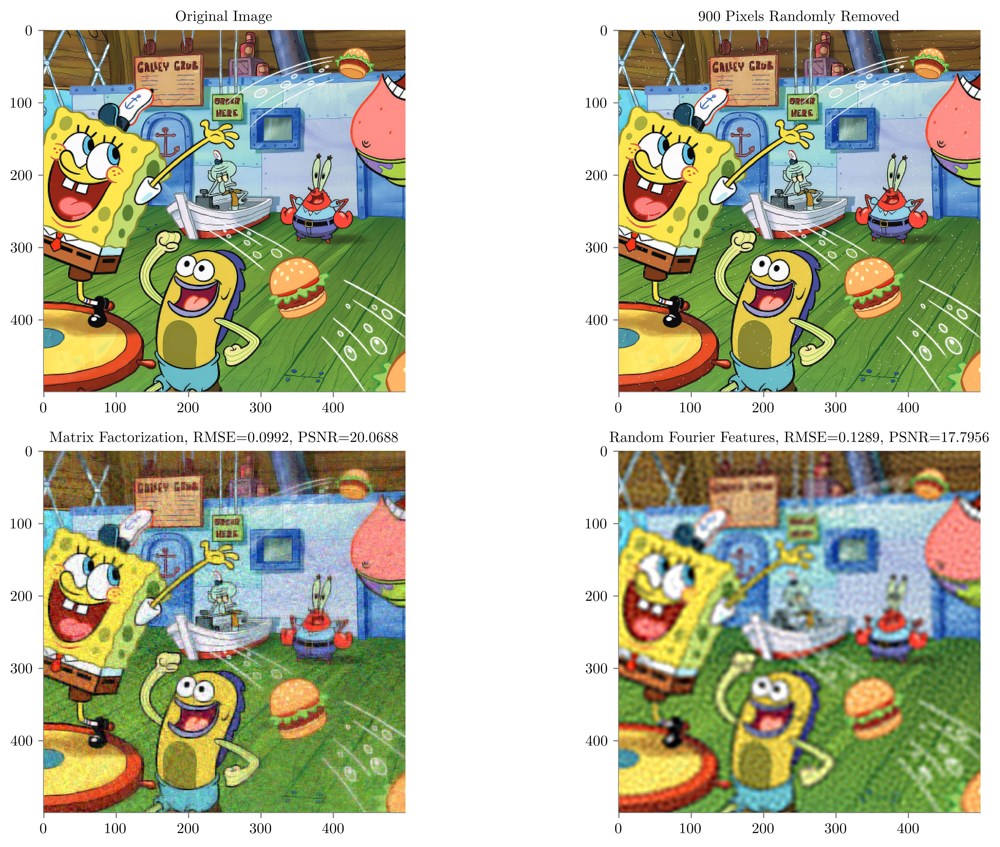

In [7]:
plot_rff_mf_comparision(img=krustykrab, r=100, sigma=4, features=10000, device=device)